In [1]:
import pandas as pd
import numpy as np
import os
import folium
from folium import plugins
import geopandas
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
ROOT = "C:/Users/Beau/Documents/GitHub/RealEstate"
RAW = os.path.join(ROOT, "data", "raw")
SERIALIZED = os.path.join(ROOT, "data", "serialized")
CLEANED = os.path.join(ROOT, "data", "processed")

In [3]:
# serialize data
# path = os.path.join(RAW, "Business_Licenses.csv")
# df = pd.read_csv(path)
# df.to_pickle(os.path.join(SERIALIZED, "Business_Licenses.pkl"))

In [4]:
df = pd.read_pickle(os.path.join(SERIALIZED, "Business_Licenses.pkl"))

In [5]:
# format dates
df["DATE ISSUED"] = pd.to_datetime(df["DATE ISSUED"])
df["issue_day"] = df["DATE ISSUED"].dt.day
df["issue_month"] = df["DATE ISSUED"].dt.month
df["issue_year"] = df["DATE ISSUED"].dt.year

# format zip codes
df = df.loc[df["ZIP CODE"].notnull()]
df["ZIP CODE"] = df["ZIP CODE"].astype(str)
exclude_zips = df["ZIP CODE"].str.contains("[a-zA-Z]")
df = df.loc[~exclude_zips]
df["ZIP CODE"] = df["ZIP CODE"].str.extract("([\d]+)")[0].astype(int)

In [6]:
# filter out unnecessary rows

# remove licenses not in Chicago
df = df.loc[df.CITY == "CHICAGO"]
zip_code_freqs = df["ZIP CODE"].value_counts()
include_zips = zip_code_freqs[zip_code_freqs > 1000].index.tolist()
df = df.loc[df["ZIP CODE"].isin(include_zips)]

# remove licenses without coordinate information
df = df.loc[df["LATITUDE"].notnull()]

# subset to business licenses issued since 2016
# idx = df["DATE ISSUED"] > pd.to_datetime("1/1/2016")
# df_new = df.loc[idx]

# limit to food licenses
# df_food = df.loc[df['LICENSE DESCRIPTION'].str.contains("Food")]

In [7]:
# drop unnecessary columns
df.drop([
    "ID",
    "ACCOUNT NUMBER",
    "SITE NUMBER",
    "CITY",
    "STATE",
    "PAYMENT DATE",
    "CONDITIONAL APPROVAL",
    "WARD PRECINCT",
    "LICENSE CODE",
    "BUSINESS ACTIVITY ID",
    "APPLICATION CREATED DATE",
    "LICENSE APPROVED FOR ISSUANCE",
    "LICENSE STATUS CHANGE DATE",
    "LICENSE TERM EXPIRATION DATE",
    "APPLICATION REQUIREMENTS COMPLETE",
    "LICENSE STATUS",
    "LOCATION"
], axis=1, inplace=True)

In [8]:
print(df.shape)
df.columns

(995994, 20)


Index(['LICENSE ID', 'LEGAL NAME', 'DOING BUSINESS AS NAME', 'ADDRESS',
       'ZIP CODE', 'WARD', 'PRECINCT', 'POLICE DISTRICT',
       'LICENSE DESCRIPTION', 'BUSINESS ACTIVITY', 'LICENSE NUMBER',
       'APPLICATION TYPE', 'LICENSE TERM START DATE', 'DATE ISSUED', 'SSA',
       'LATITUDE', 'LONGITUDE', 'issue_day', 'issue_month', 'issue_year'],
      dtype='object')

<AxesSubplot:xlabel='issue_year'>

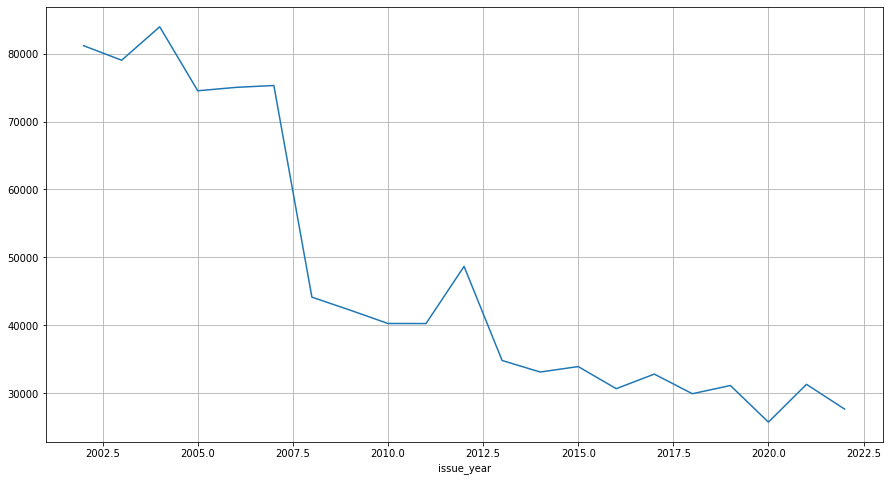

In [9]:
df.groupby("issue_year")["LICENSE ID"].count().plot(figsize=(15,8), grid=True)

In [10]:
df_plot = df.groupby(["issue_year", "ZIP CODE"])["LICENSE ID"].count().reset_index()
df_plot["ZIP CODE"] = df_plot["ZIP CODE"].astype(str)

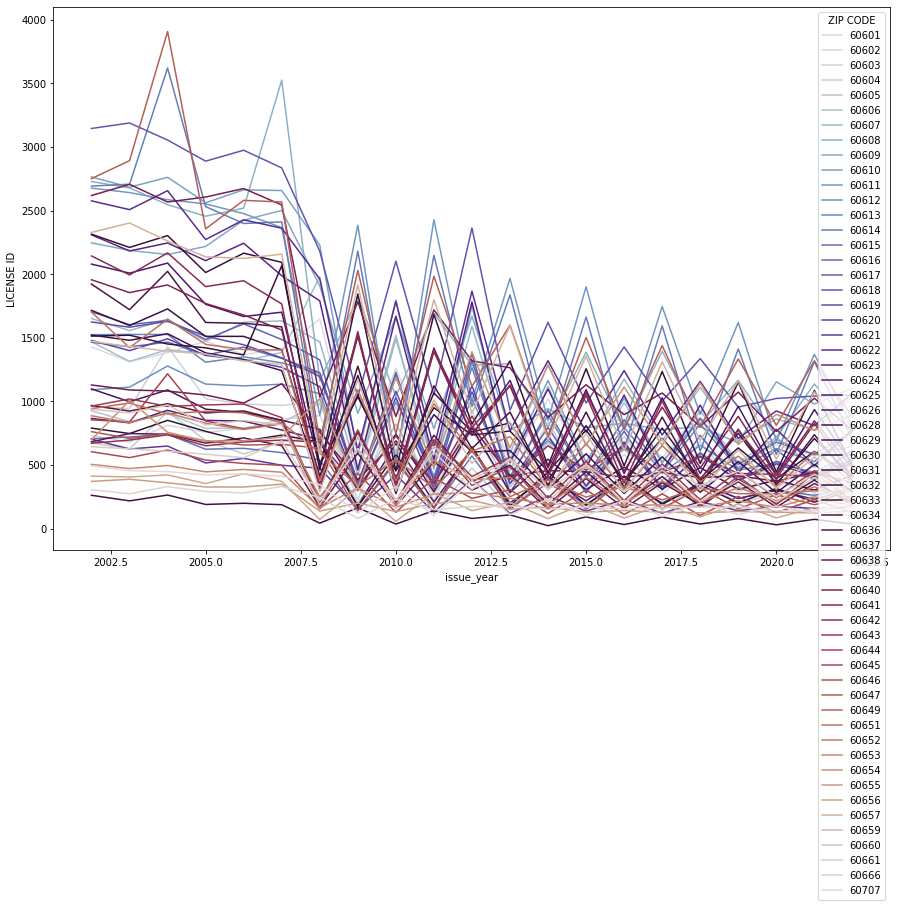

In [11]:
plt.rcParams["figure.figsize"] = (15,10)

sns.lineplot(x="issue_year", y="LICENSE ID", hue="ZIP CODE", palette="twilight", data=df_plot)

plt.show()

In [12]:
m = folium.Map(location=[41.8781, -87.6298], zoom_start=11)

geometry = geopandas.points_from_xy(df.LONGITUDE, df.LATITUDE)
heat_data = [[point.xy[1][0], point.xy[0][0]] for point in geometry]

In [13]:
plugins.HeatMap(heat_data, radius=2, blur=2).add_to(m)

m

In [14]:
df.to_pickle(os.path.join(CLEANED, "Business_Licenses.pkl"))